# Object Detection Tutorial

In this tutorial, you will learn how to use an object detector model (DETIC) to extract objects from Aria frames.

Additionally, you will be able to interact with the LLM using the detection results via langchain, which allows for the extraction of food ingredients and the generation of recipes.

### Notebook stuck?
Note that because of Jupyter issues, sometimes the code may stuck at visualization. We recommend **restart the kernels** and try again to see if the issue is resolved.

## Step 1. Install Project Aria Tools
Run the following cell to install Project Aria Tools for reading Aria recordings in .vrs format

In [16]:
# Specifics for Google Colab
google_colab_env = 'google.colab' in str(get_ipython())
print("Running from Google Colab, installing projectaria_tools")
!pip install projectaria-tools

Running from Google Colab, installing projectaria_tools


## Step 2. Prepare an Aria recording

We will set the vrsfile path to your collected Aria recording.

Upload your Aria recording in your Google Drive before running the cell.

Here, we assume it is uploaded to **`My Drive/Fridge/87327912-42f4-4295-8f24-ceac8912d9ec.vrs`**

*(You can check the content of the mounted drive by running `!ls "/content/drive/My Drive/"` in a cell.)*



In [48]:
from google.colab import drive
import os
drive.flush_and_unmount()
drive.mount('/content/drive/')
my_vrs_file_path = 'Fridge/87327912-42f4-4295-8f24-ceac8912d9ec.vrs'
vrsfile = "/content/drive/My Drive/" + my_vrs_file_path
print(f"INFO: vrsfile set to {vrsfile}")

Mounted at /content/drive/
INFO: vrsfile set to /content/drive/My Drive/Fridge/87327912-42f4-4295-8f24-ceac8912d9ec.vrs


## Step 3. Create data provider

Create projectaria data_provider so you can load the content of the vrs file.

In [49]:
from projectaria_tools.core import data_provider, calibration
from projectaria_tools.core.sensor_data import TimeDomain, TimeQueryOptions
from projectaria_tools.core.stream_id import RecordableTypeId, StreamId
import numpy as np
from matplotlib import pyplot as plt

print(f"Creating data provider from {vrsfile}")
provider = data_provider.create_vrs_data_provider(vrsfile)
if not provider:
    print("Invalid vrs data provider")

Creating data provider from /content/drive/My Drive/Fridge/87327912-42f4-4295-8f24-ceac8912d9ec.vrs


## Step 4. Display VRS rgb content in thumbnail images

Goals:
- Summarize a VRS using 20 image side by side, to visually inspect the collected data.

Key learnings:
- Image streams are identified with a Unique Identifier: stream_id
- Image frames are identified with timestamps
- PIL images can be created from Numpy array

Customization
- To change the number of sampled images, change the variable `sample_count` to a desired number.
- To change the thumbnail size, change the variable `resize_ratio` to a desired value.

100%|██████████| 20/20 [00:05<00:00,  3.35it/s]


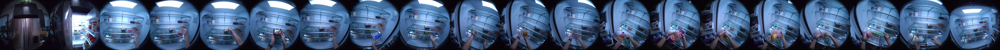

In [63]:
from PIL import Image
from tqdm import tqdm

sample_count = 20
resize_ratio = 10

rgb_stream_id = StreamId("214-1")

# Retrieve image size for the RGB stream
time_domain = TimeDomain.DEVICE_TIME  # query data based on host time
option = TimeQueryOptions.CLOSEST # get data whose time [in TimeDomain] is CLOSEST to query time

# Retrieve Start and End time for the given Sensor Stream Id
start_time = provider.get_first_time_ns(rgb_stream_id, time_domain)
end_time = provider.get_last_time_ns(rgb_stream_id, time_domain)

image_config = provider.get_image_configuration(rgb_stream_id)
width = image_config.image_width
height = image_config.image_height

thumbnail = newImage = Image.new(
    "RGB", (int(width * sample_count / resize_ratio), int(height / resize_ratio))
)
current_width = 0


# Samples 10 timestamps
sample_timestamps = np.linspace(start_time, end_time, sample_count)
for sample in tqdm(sample_timestamps):
    image_tuple = provider.get_image_data_by_time_ns(rgb_stream_id, int(sample), time_domain, option)
    image_array = image_tuple[0].to_numpy_array()
    image = Image.fromarray(image_array)
    new_size = (
        int(image.size[0] / resize_ratio),
        int(image.size[1] / resize_ratio),
    )
    image = image.resize(new_size).rotate(-90)
    thumbnail.paste(image, (current_width, 0))
    current_width = int(current_width + width / resize_ratio)

from IPython.display import Image
display(thumbnail)

## Step 5. Install DETIC
### Install Detectron2
Install Detectron2 as DETIC depends on Detectron2

In [ ]:
# Install detectron2
import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# Use the below line to install detectron2 if the above one has an error
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git@v0.6'

### Install DETIC

In [ ]:
# clone and install Detic
!git clone https://github.com/facebookresearch/Detic.git --recurse-submodules
%cd Detic
!pip install -r requirements.txt

## Step 6. Load DETIC Model

### Set config for the model

In [27]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import sys
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Detic libraries
sys.path.insert(0, 'third_party/CenterNet2')
from centernet.config import add_centernet_config
from detic.config import add_detic_config
from detic.modeling.utils import reset_cls_test

# Build the detector and download our pretrained weights
cfg = get_cfg()
add_centernet_config(cfg)
add_detic_config(cfg)
cfg.merge_from_file("configs/Detic_LCOCOI21k_CLIP_SwinB_896b32_4x_ft4x_max-size.yaml")
cfg.MODEL.WEIGHTS = 'https://dl.fbaipublicfiles.com/detic/Detic_LCOCOI21k_CLIP_SwinB_896b32_4x_ft4x_max-size.pth'
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.ROI_BOX_HEAD.ZEROSHOT_WEIGHT_PATH = 'rand'
cfg.MODEL.ROI_HEADS.ONE_CLASS_PER_PROPOSAL = True # For better visualization purpose. Set to False for all classes.
# cfg.MODEL.DEVICE='cpu' # uncomment this to use cpu-only mode.
predictor = DefaultPredictor(cfg)


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[10/23 17:45:24 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detic/Detic_LCOCOI21k_CLIP_SwinB_896b32_4x_ft4x_max-size.pth ...


Detic_LCOCOI21k_CLIP_SwinB_896b32_4x_ft4x_max-size.pth: 702MB [00:35, 20.1MB/s]                           


### Load DETIC Model

In [28]:
# Setup the model's vocabulary using build-in datasets

BUILDIN_CLASSIFIER = {
    'lvis': 'datasets/metadata/lvis_v1_clip_a+cname.npy',
    'objects365': 'datasets/metadata/o365_clip_a+cnamefix.npy',
    'openimages': 'datasets/metadata/oid_clip_a+cname.npy',
    'coco': 'datasets/metadata/coco_clip_a+cname.npy',
}

BUILDIN_METADATA_PATH = {
    'lvis': 'lvis_v1_val',
    'objects365': 'objects365_v2_val',
    'openimages': 'oid_val_expanded',
    'coco': 'coco_2017_val',
}

vocabulary = 'lvis' # change to 'lvis', 'objects365', 'openimages', or 'coco'
metadata = MetadataCatalog.get(BUILDIN_METADATA_PATH[vocabulary])
classifier = BUILDIN_CLASSIFIER[vocabulary]
num_classes = len(metadata.thing_classes)
reset_cls_test(predictor.model, classifier, num_classes)

Resetting zs_weight datasets/metadata/lvis_v1_clip_a+cname.npy


## Step 7. Run DETIC

Run DETIC for each sampled timestamps in Step 4. The detected object list will be stored in `objects_dict`.

You can set the image size using the `imsize` variable.

DETIC is an object detection model from FAIR.

"*Detecting Twenty-thousand Classes using Image-level Supervision*",
*Xingyi Zhou, Rohit Girdhar, Armand Joulin, Philipp Krähenbühl, Ishan Misra, ECCV 2022*
- Paper: https://arxiv.org/abs/2201.02605
- Code: https://github.com/facebookresearch/Detic

  0%|          | 0/20 [00:00<?, ?it/s]

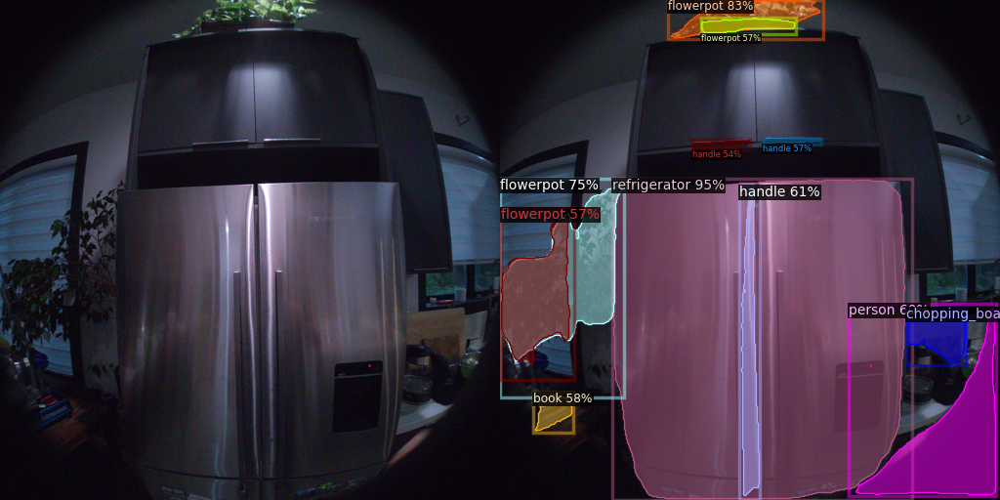

  5%|▌         | 1/20 [00:00<00:15,  1.26it/s]

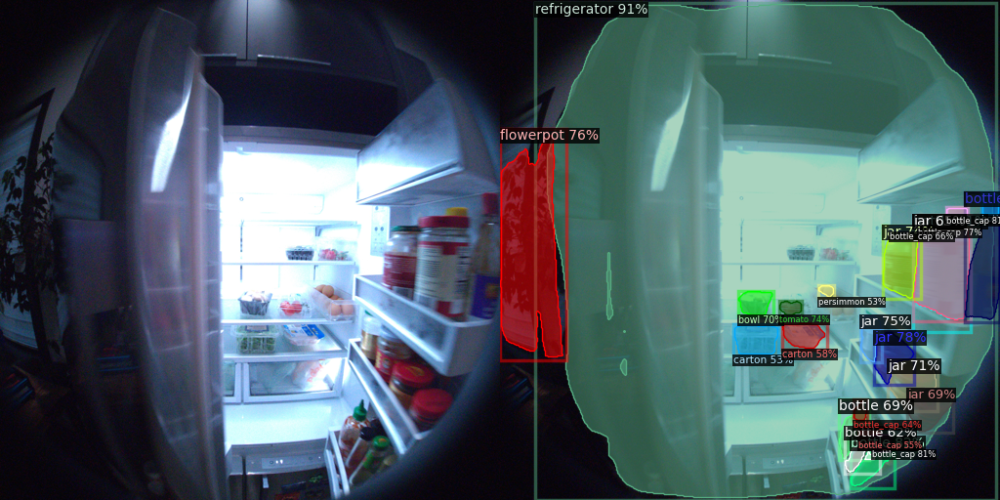

 10%|█         | 2/20 [00:01<00:15,  1.16it/s]

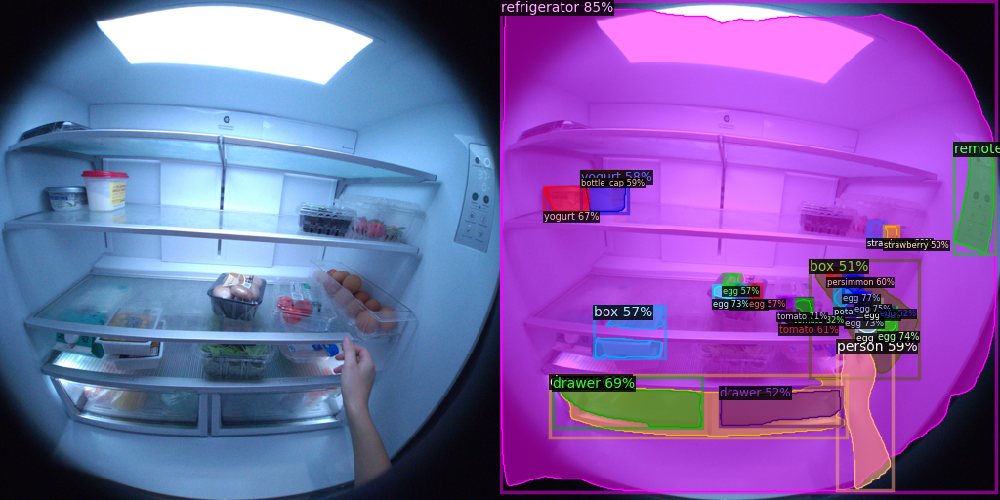

 15%|█▌        | 3/20 [00:02<00:16,  1.05it/s]

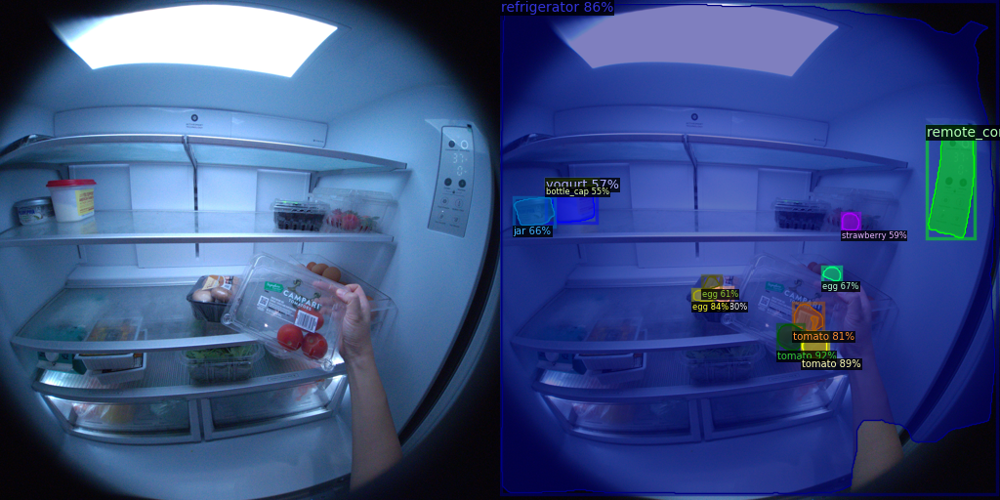

 20%|██        | 4/20 [00:03<00:14,  1.09it/s]

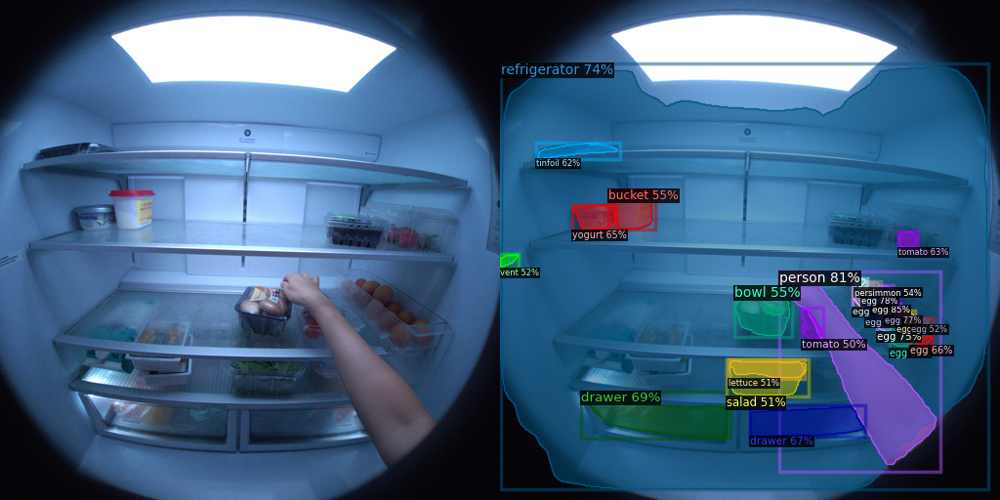

 25%|██▌       | 5/20 [00:04<00:15,  1.02s/it]

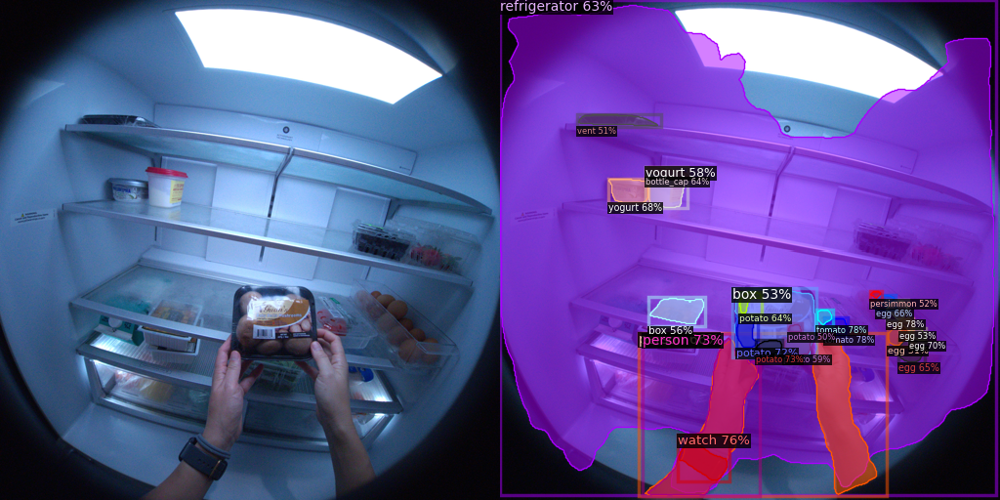

 30%|███       | 6/20 [00:05<00:14,  1.04s/it]

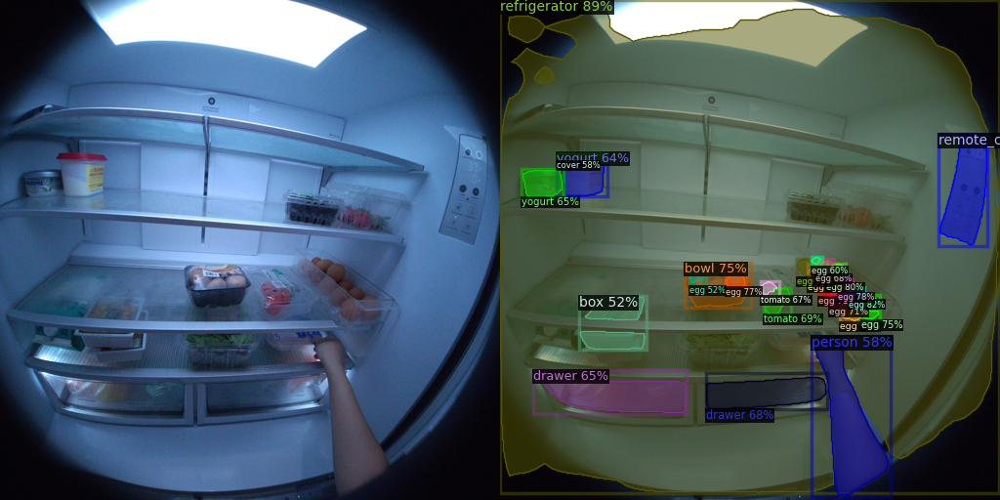

 35%|███▌      | 7/20 [00:07<00:14,  1.12s/it]

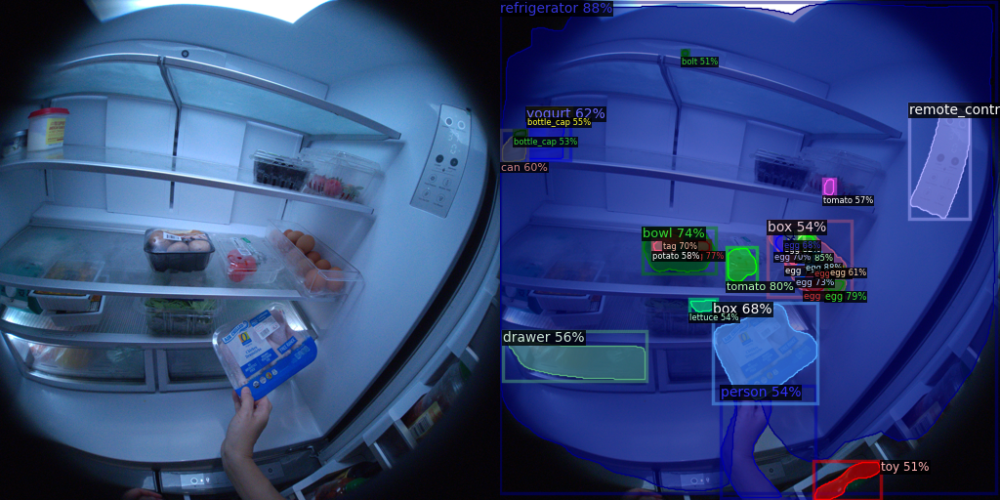

 40%|████      | 8/20 [00:08<00:15,  1.28s/it]

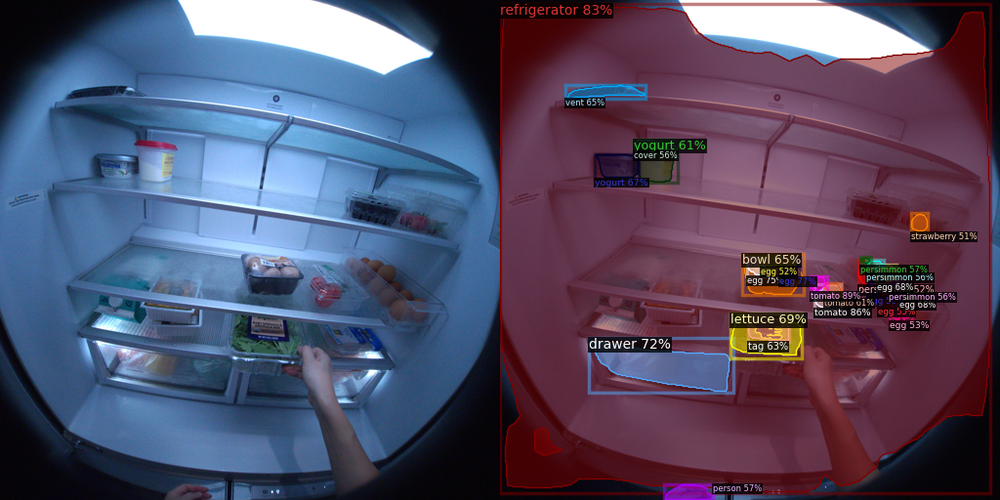

 45%|████▌     | 9/20 [00:10<00:13,  1.27s/it]

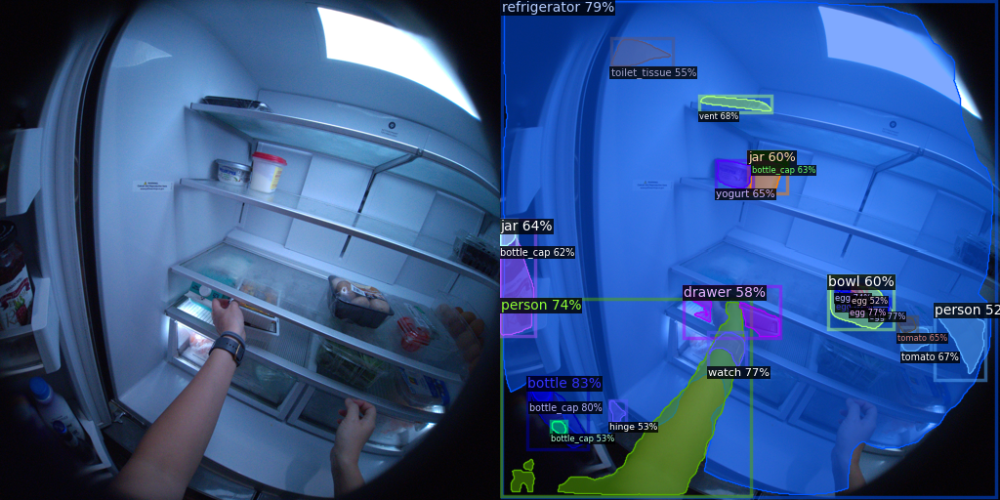

 50%|█████     | 10/20 [00:11<00:12,  1.27s/it]

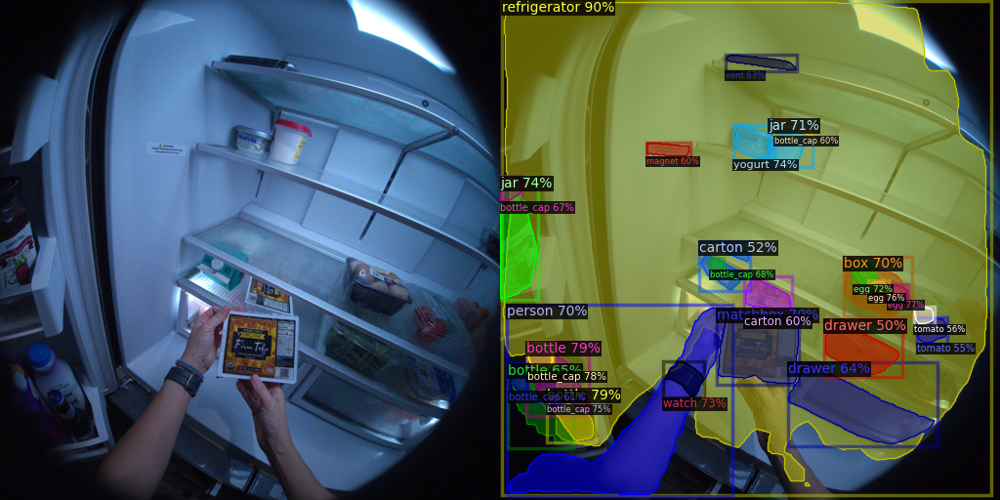

 55%|█████▌    | 11/20 [00:12<00:11,  1.31s/it]

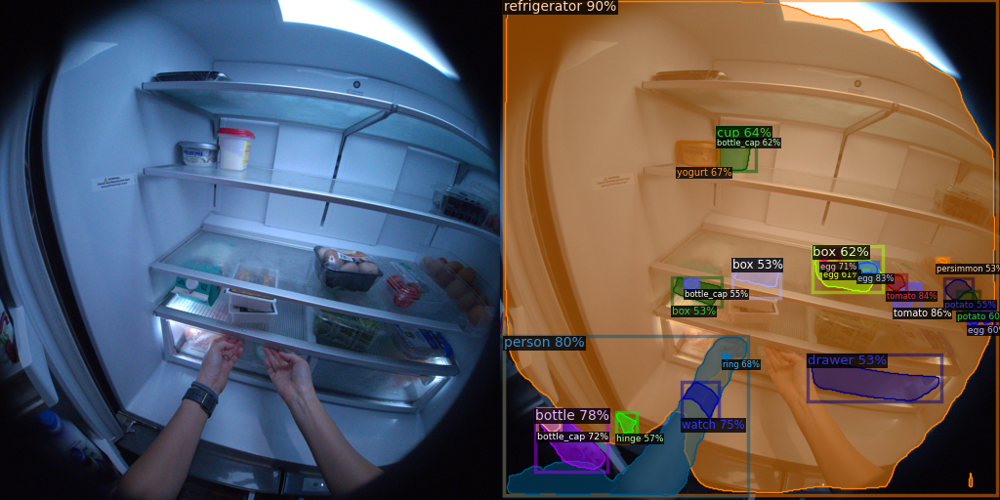

 60%|██████    | 12/20 [00:13<00:10,  1.25s/it]

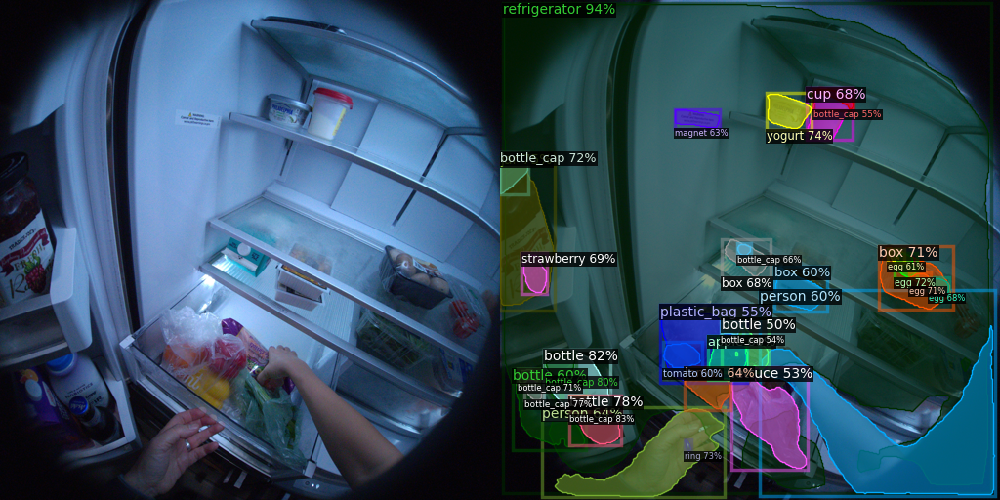

 65%|██████▌   | 13/20 [00:14<00:08,  1.21s/it]

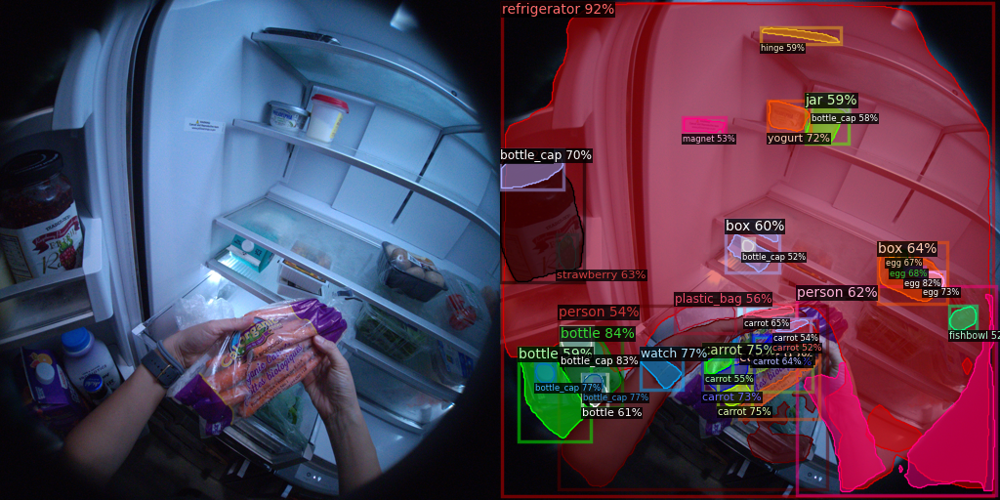

 70%|███████   | 14/20 [00:16<00:07,  1.19s/it]

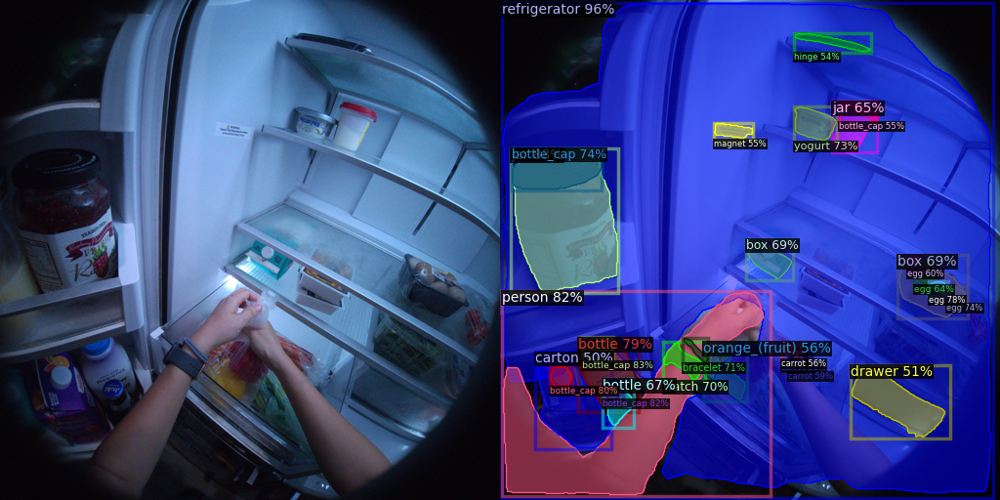

 75%|███████▌  | 15/20 [00:17<00:05,  1.15s/it]

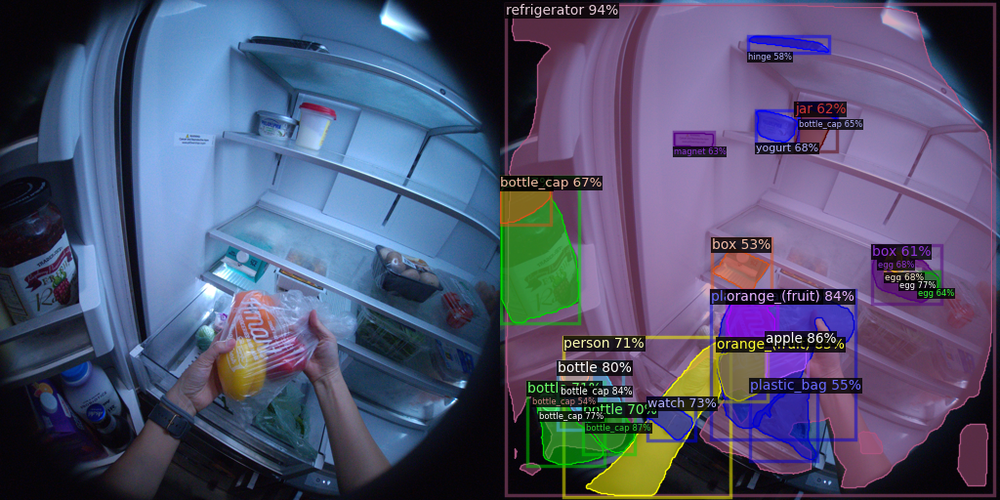

 80%|████████  | 16/20 [00:18<00:04,  1.13s/it]

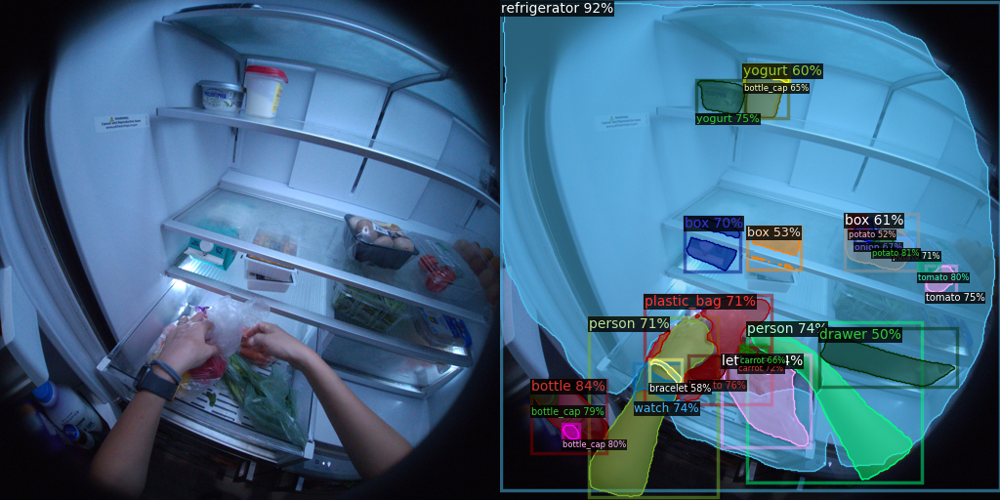

 85%|████████▌ | 17/20 [00:19<00:03,  1.12s/it]

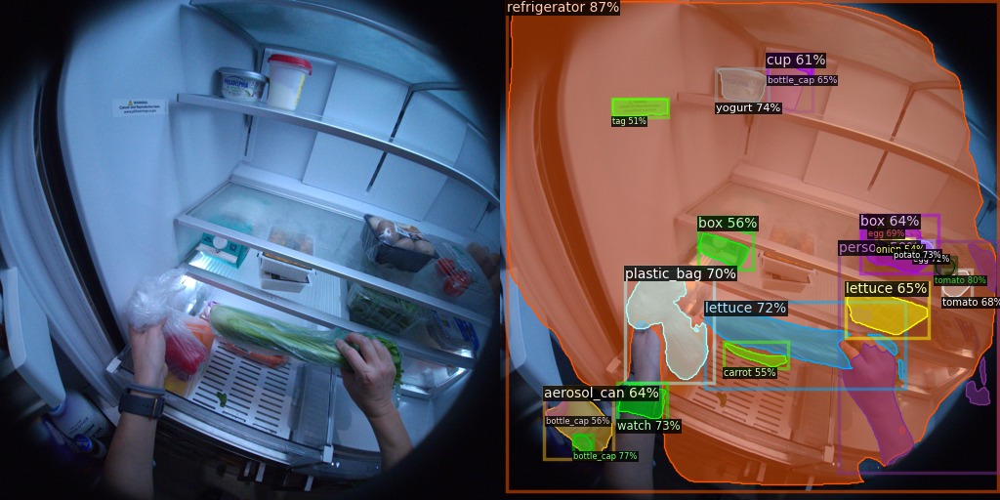

 90%|█████████ | 18/20 [00:20<00:02,  1.10s/it]

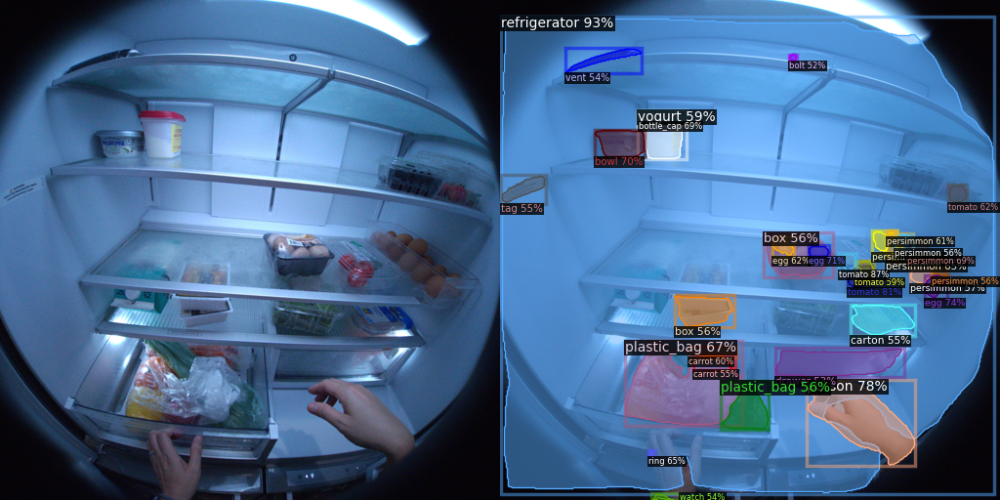

 95%|█████████▌| 19/20 [00:21<00:01,  1.09s/it]

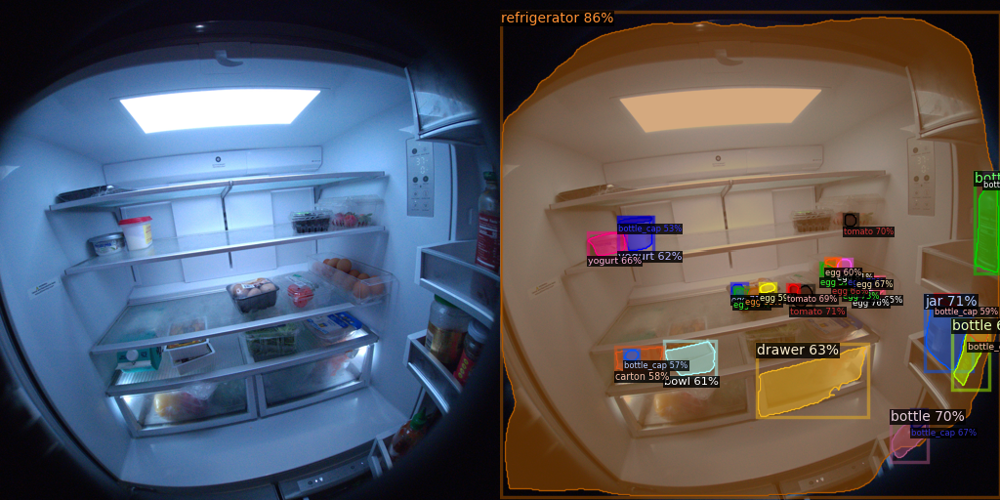

100%|██████████| 20/20 [00:22<00:00,  1.14s/it]


In [84]:
imsize = 512

objects_dict = {
    'timestamps': [],
    'objects': []
}

for sample in tqdm(sample_timestamps):
    # Fetch image
    image_tuple = provider.get_image_data_by_time_ns(rgb_stream_id, int(sample), time_domain, option)
    image_array = image_tuple[0].to_numpy_array()
    image = Image.fromarray(image_array)
    new_size = (imsize, imsize)
    image = np.asarray(image.resize(new_size).rotate(-90))
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    # Run model and show results
    outputs = predictor(image)
    v = Visualizer(image[:, :, ::-1], metadata)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    output_image = out.get_image()[:, :, ::-1]

    object_list = list(set([metadata.thing_classes[x] for x in outputs["instances"].pred_classes.cpu().tolist()]))

    objects_dict['timestamps'].append(sample)
    objects_dict['objects'].append(object_list)

    combined_image = np.hstack((image, output_image))
    cv2_imshow(combined_image)


## Step 8. Display and save detected object lists

### We can get object detection results for each timestamps.

In [86]:
objects_save_path = '/content/object_detections.csv'

import pandas as pd
df = pd.DataFrame(objects_dict)
df.to_csv(objects_save_path)
display(df)

,timestamps,objects
0,1.641293e+12,"[handle, flowerpot, person, book, refrigerator..."
1,1.643188e+12,"[jar, flowerpot, persimmon, tomato, refrigerat..."
2,1.645082e+12,"[bottle_cap, persimmon, egg, potato, drawer, r..."
3,1.646977e+12,"[jar, bottle_cap, egg, remote_control, tomato,..."
4,1.648872e+12,"[tinfoil, vent, persimmon, salad, egg, drawer,..."
5,1.650766e+12,"[bottle_cap, watch, persimmon, egg, potato, pe..."
6,1.652661e+12,"[cover, egg, drawer, remote_control, person, t..."
7,1.654556e+12,"[yogurt, bottle_cap, toy, tag, egg, potato, bo..."
8,1.656451e+12,"[bowl, cover, tag, persimmon, egg, drawer, per..."
9,1.658345e+12,"[yogurt, jar, bowl, hinge, watch, toilet_tissu..."


### We will aggregate these object list, and feed to an LLM.

In [89]:
agg_obj_list = list(set([item for sublist in objects_dict['objects'] for item in sublist]))

print(agg_obj_list)

['flowerpot', 'egg', 'potato', 'bolt', 'cup', 'handle', 'chopping_board', 'lemon', 'lettuce', 'fishbowl', 'cover', 'hinge', 'refrigerator', 'salad', 'toilet_tissue', 'apple', 'bucket', 'carrot', 'yogurt', 'box', 'bracelet', 'bottle', 'magnet', 'vent', 'tinfoil', 'plastic_bag', 'onion', 'tag', 'persimmon', 'watch', 'ring', 'person', 'book', 'tomato', 'bottle_cap', 'strawberry', 'can', 'bowl', 'aerosol_can', 'toy', 'drawer', 'remote_control', 'jar', 'carton', 'orange_(fruit)', 'matchbox']


## Step 9. Install Langchain

In [ ]:
!pip install langchain

## Step 10. Install OpenAI to use with Langchain

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!pip install openai

## Step 11. Get ingredients and recipes

We ask LLM to get food ingredients from the object detection result (`agg_obj_list`), and then ask it to provide recipes.


In [96]:
from langchain.chat_models import ChatOpenAI
from langchain import PromptTemplate
from langchain.prompts.chat import ChatPromptTemplate

os.environ["OPENAI_API_KEY"] = "sk-your-key"
chat_model = ChatOpenAI()

response = chat_model.predict(f"List food ingredients in this list: {', '.join(agg_obj_list)}")
print(response)

egg, potato, lemon, lettuce, apple, carrot, yogurt, onion, persimmon, tomato, strawberry, orange (fruit)


In [98]:
template = "You are a helpful culinary assistant that provides recipes given a list of ingredients."
human_template = "{text}"

chat_prompt = ChatPromptTemplate.from_messages([
    ("system", template),
    ("human", human_template),
])


chain = chat_prompt | ChatOpenAI()
recipe = chain.invoke({"text": response})

In [100]:
print(recipe.content)

Here are a few recipes you can make with the ingredients you provided:

1. Greek Potato Salad:
- Ingredients: potato, lettuce, onion, yogurt, lemon
- Instructions: Boil the potatoes until tender. Let them cool, then cube them. Mix together the potatoes, lettuce, finely chopped onion, and a dressing made with yogurt and lemon juice. Season with salt and pepper to taste. Serve chilled.

2. Carrot Apple Muffins:
- Ingredients: carrot, apple, egg, yogurt
- Instructions: Preheat the oven to 350°F (175°C). Grate the carrots and apples. In a mixing bowl, beat the eggs and add yogurt. Then, add the grated carrots and apples. Mix well. Pour the batter into muffin cups and bake for about 20 minutes or until a toothpick inserted comes out clean.

3. Persimmon Salad:
- Ingredients: persimmon, lettuce, tomato, onion
- Instructions: Slice the persimmons, tomatoes, and onions. Arrange them on a bed of lettuce. Drizzle with lemon juice or a light dressing of your choice. Serve as a refreshing salad.



## Step 12. Personalized recipes
You have the ability to personalize the recipe based on your individual preferences. In this example, we demonstrate how to input preferences manually, but in an ideal scenario, this information would be obtained from your digital data.

In [102]:
template = """
You are a helpful culinary assistant that provides recipes given a list of ingredients.
I like healthy meals, and I enjoy mediterranean food.
"""
human_template = "{text}"

chat_prompt = ChatPromptTemplate.from_messages([
    ("system", template),
    ("human", human_template),
])


chain = chat_prompt | ChatOpenAI()
recipe = chain.invoke({"text": response})
print(recipe.content)

Here's a Mediterranean-inspired recipe that incorporates some of the ingredients you provided: Lemon Potato Salad.

Ingredients:
- 4 potatoes, boiled and diced
- 1 small onion, finely chopped
- 1 lemon, juiced and zested
- 2 tablespoons extra virgin olive oil
- Salt and pepper, to taste
- 1 cup lettuce, chopped
- 1 small apple, diced
- 1 carrot, grated
- 1 persimmon, diced

Instructions:
1. In a large mixing bowl, combine the diced potatoes, chopped onion, lemon juice, lemon zest, olive oil, salt, and pepper. Mix well to coat the potatoes.
2. Add the lettuce, diced apple, grated carrot, and diced persimmon to the bowl. Toss gently to combine all the ingredients.
3. Adjust the seasoning if needed, and refrigerate for at least 30 minutes to allow the flavors to meld together.
4. Serve chilled as a side dish or as a light lunch option.

Optional: You can also add chopped tomatoes and sliced strawberries to add more color and flavor to the salad. Enjoy your healthy Mediterranean meal!
